In [1]:
import pandas as pd
from wfield import *
import pickle
import sys
import os
sys.path.append(os.path.dirname(os.getcwd()))
from NatMovie_utils import *


In [2]:
os.environ['CUDA_VISIBLE_DEVICES'] = '2'
import cupy as cp

In [3]:
path_wfield = r'/home/lzx/data/WF_VC_liuzhaoxi/24.12.19_P41/natural-movie/process/20241219-192319-wfield'

experiment = os.path.basename(path_wfield)[:15]
mouse = os.path.normpath(path_wfield).split(os.sep)[5].split('_')[1]
path_out = pjoin(path_wfield, '..', experiment + '-natural-movie--')
os.makedirs(path_out, exist_ok=True)
print(experiment,mouse)
trialfile = pd.read_csv(pjoin(path_wfield, 'trials.csv'), header=None).values.astype(int)
rawPath = pjoin(path_wfield, '../../raw')
movie_folder = pjoin(rawPath, 'natural_movies')
movie_list = pd.read_csv(pjoin(movie_folder, 'movie_list.txt'), header=None).values
n_movie = movie_list.size
movie_name_list = []
for imovie in range(n_movie):
    movie_name_list.append(str(movie_list[imovie])[2:-6])

n_frame = 150  # 帧
pre_length = 20
after_lenth = 30
whole_length = trialfile[-1, 2]+50
frames_average = np.load(pjoin(path_wfield, 'frames_average.npy')).astype('float32')


20241219-192319 P41


In [8]:

if os.path.exists(pjoin(path_out, f'{mouse}_{experiment}_tif_sort.npy')):
    print('loading tif_sort.npy')
    tif_sort1=cp.load(pjoin(path_out, f'{mouse}_{experiment}_tif_sort.npy'))
    tif_sort=cp.asnumpy(tif_sort1)
    print('tiff_sort.shape: (height, width, n_frame, n_movie, n_rep) ', tif_sort.shape)
    tif_height,tif_width = tif_sort.shape[:2]
    n_rep = tif_sort.shape[-1]

else:
    # tif = mmap_dat(glob(pjoin(path_wfield, "*.bin"))[0])
    # tif470 = (tif[:,0]-frames_average[0])/frames_average[0]
    # tif405 = (tif[:,1]-frames_average[1])/frames_average[1]
    # tif_corr=tif470-tif405
    # print('finish tif_corr')
    # tif_height,tif_width=tif_corr.shape[1:]

    U = cp.load(pjoin(path_wfield, 'U.npy')).astype('float32')
    SVT = cp.load(pjoin(path_wfield, 'SVT.npy')).astype('float32')
    SVT_470 = SVT[:,::2]
    SVT_405 = SVT[:,1::2]
    SVTcorr = SVT_470-SVT_405
    # SVTcorr = cp.load(pjoin(path_wfield, 'SVTcorr.npy')).astype('float32')
    tif_height, tif_width = U.shape[:2]

    # SVTcorr_sort维度：[nSVD, n_frame, n_movie, n_rep]
    SVTcorr_sort = Gsorting_NatMov(SVTcorr, trialfile[:, 1], n_movie, n_frame, pre_length, after_lenth).astype('float32')
    n_rep = SVTcorr_sort.shape[-1]
    tif_sort1 = cp.tensordot(U, SVTcorr_sort, axes=(2, 0)).astype('float32')
    tif_sort=cp.asnumpy(tif_sort1)
    np.save(pjoin(path_out, f'{mouse}_{experiment}_tif_sort.npy'), tif_sort)
    print('finish save tif_sort.npy')
    print('tif_sort维度：[width, height, n_frame, n_movie, n_rep]')
    print(tif_sort.shape)


    # tif_corr1=cp.asarray(tif_corr[:whole_length])
    # tif_sort2 = Gsorting_NatMov(tif_corr1.reshape(-1,tif_height*tif_width).T, trialfile[:, 1], n_movie, n_frame, pre_length, after_lenth).astype('float32')
    # tif_sort1 = tif_sort2.reshape(tif_height,tif_width,*tif_sort2.shape[1:])
    # tif_sort=cp.asnumpy(tif_sort1)
    # del tif_sort1, tif_sort2, tif_corr1

    # tif_sort = sorting_NatMov(tif_corr.reshape(-1,tif_height*tif_width).T, trialfile[:, 1], n_movie, n_frame, pre_length, after_lenth).astype('float32')
    # tif_sort = tif_sort.reshape(tif_height,tif_width,*tif_sort.shape[1:])
    # n_rep = tif_sort.shape[-1]
    # print('tif_sort.shape: (height, width, n_frame, n_movie, n_rep) ', tif_sort.shape)
    # np.save(pjoin(path_out, 'tif_sort.npy'), tif_sort)
    # print('finish save tif_sort.npy')



loading tif_sort.npy


In [ ]:
# load CCF

from wfield import *

lmarks = load_allen_landmarks(pjoin(path_wfield, '../../../', 'dorsal_cortex_landmarks.json'))
ccf_regions_reference, proj, brain_outline = allen_load_reference('dorsal_cortex')
# this loads the untransformed atlas
atlas_im, areanames, brain_mask = atlas_from_landmarks_file(pjoin(path_wfield, '../../../', 'dorsal_cortex_landmarks.json'),
                                                            do_transform=True)
# this converts the reference to image space (unwarped)
ccf_regions_im = allen_transform_regions(lmarks['transform'], ccf_regions_reference,
                                         resolution=lmarks['resolution'],
                                         bregma_offset=lmarks['bregma_offset'])


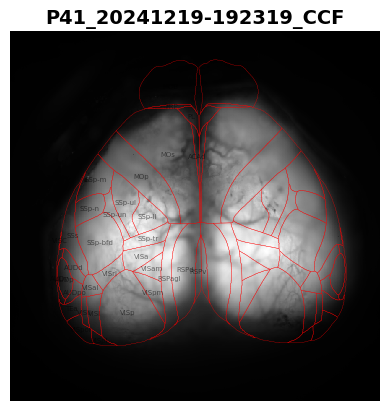

In [ ]:
# plot avg_frame & CCF

fig = plt.figure()
plt.imshow(frames_average[0], cmap='gray')
for i, r in ccf_regions_im.iterrows():
    plt.plot(r['left_x'], r['left_y'], 'r', lw=0.2)
    plt.plot(r['right_x'], r['right_y'], 'r', lw=0.2)
    plt.text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=5, alpha=0.5, ha='center')

plt.axis('off')
plt.title(f'{mouse}_{experiment}_CCF')
fig.set_facecolor('white')
plt.savefig(pjoin(path_out, f'{mouse}_{experiment}_ccf.png'), bbox_inches='tight', pad_inches=0)
plt.show()


In [7]:
from skimage.transform import warp

ccf_regions = allen_transform_regions(None,ccf_regions_reference,
                                      resolution = lmarks['resolution'],
                                        bregma_offset = lmarks['bregma_offset'])

frames_average_warped = warp(frames_average.transpose(1,2,0),lmarks['transform'],
                order = 1, mode='constant', cval = 0, clip=True, preserve_range=True, output_shape=(540, 640)).transpose(2,0,1)


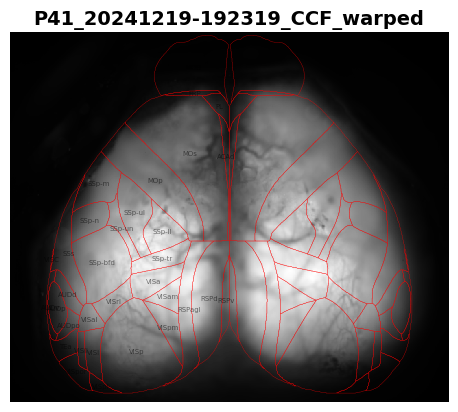

In [19]:
# plot warped avg_frame & CCF

fig = plt.figure()
plt.imshow(frames_average_warped[0], cmap='gray')
for i, r in ccf_regions.iterrows():
    plt.plot(r['left_x'], r['left_y'], 'r', lw=0.2)
    plt.plot(r['right_x'], r['right_y'], 'r', lw=0.2)
    plt.text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=5, alpha=0.5, ha='center')

plt.axis('off')
plt.title(f'{mouse}_{experiment}_CCF_warped')
fig.set_facecolor('white')
plt.savefig(pjoin(path_out, f'{mouse}_{experiment}_ccf_warped.png'), bbox_inches='tight', pad_inches=0)
plt.show()

In [19]:
def flat_mask(Uflat,xy):
    # index are in xy, like what np.where(mask) returns
    x = np.array(np.clip(xy[0],0,tif_height-1),dtype=int)
    y = np.array(np.clip(xy[1],0,tif_width-1),dtype=int)
    idx = np.ravel_multi_index((x,y),(tif_height,tif_width))
    t = Uflat[idx,:]
    return t

tif_sort_flat= cp.asnumpy(tif_sort.reshape(tif_height*tif_width,-1))
all_area_timecourse=np.empty((33, tif_sort_flat.shape[-1]))
for area in range(1,34):
    all_area_timecourse[area-1] = flat_mask(tif_sort_flat,np.where(atlas_im == area)).mean(axis=0)

np.save(pjoin(path_out, f'{mouse}_{experiment}_all_area_timecourse.npy'), all_area_timecourse.reshape(33, *SVTcorr_sort.shape[1:]))

In [ ]:
# Plot the overlap for the same region in the warped versus unwarped atlases 
bg = 0
aud=range(20,24)
soma = [5,6]
visual = range(24,34)

plt.figure(figsize = [5,5])
reg = np.zeros([*atlas_im.shape,3])
reg[:, :, 0] = np.isin(atlas_im, visual) * 200
reg[:, :, 1] = np.isin(atlas_im, soma) * 200
reg[:, :, 2] = np.isin(atlas_im, aud) * 100
plt.imshow(reg.astype('uint8'))

for i,r in ccf_regions_im.iterrows():
    for side in ['left', 'right']:
        plt.plot(np.array(r[side+'_x']),r[side +'_y'],'w',lw=1)
        plt.text(r.left_center[0], r.left_center[1], str(i+1)+'-'+r.acronym, color='w', va='center', fontsize=4, alpha=1, ha='center')
plt.axis('off')
# plt.savefig('/home/lzx/data/WF_VC_liuzhaoxi/______________natural_movie_summary/brain areas.png')
plt.show()

In [21]:
visual_timecourse = flat_mask(tif_sort_flat,np.where(np.isin(atlas_im, visual))).reshape(-1, *SVTcorr_sort.shape[1:])
soma_timecourse = flat_mask(tif_sort_flat,np.where(np.isin(atlas_im, soma))).reshape(-1, *SVTcorr_sort.shape[1:])
aud_timecourse = flat_mask(tif_sort_flat,np.where(np.isin(atlas_im, aud))).reshape(-1, *SVTcorr_sort.shape[1:])
print('visual timecourse:',visual_timecourse.shape)
print('soma timecourse:',soma_timecourse .shape)
print('aud timecourse:', aud_timecourse.shape)

VAS_timecourse= np.stack((visual_timecourse.mean(axis=0).transpose(1,0,2), 
                           aud_timecourse.mean(axis=0).transpose(1,0,2), 
                           soma_timecourse.mean(axis=0).transpose(1,0,2)), 
                           axis=0)
VA_timecourse=np.empty((10, *SVTcorr_sort.shape[1:]))
for i, i_area in enumerate(range(24,34)):
    VA_timecourse[i]=flat_mask(tif_sort_flat,np.where(np.isin(atlas_im, i_area))).reshape(-1, *SVTcorr_sort.shape[1:]).mean(axis=0)

visual timecourse: (13888, 200, 14, 5)
soma timecourse: (3140, 200, 14, 5)
aud timecourse: (2226, 200, 14, 5)


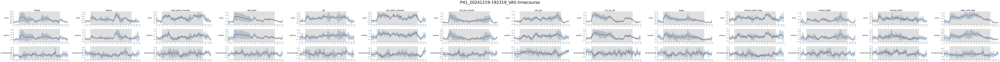

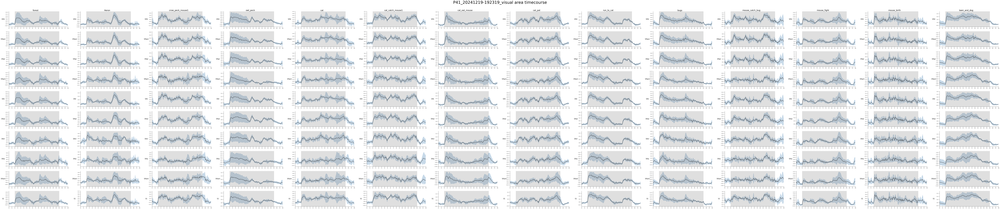

In [22]:
subplot_timecourse(VAS_timecourse, patch_list=['visual', 'auditory', 'somatosensory'], 
                   movie_name_list=movie_name_list, title=f'{mouse}_{experiment}_VAS timecourse', 
                   outpath=path_out, pre_length=20, n_frame=150, plot_rep=False, dpi=200)

VA_list=['VISli','VISpor','VISpl','VISpm','VISl','VISal','VISrl', 'VISa', 'VISam', 'V1']
subplot_timecourse(VA_timecourse.transpose(0, 2, 1, 3), patch_list=VA_list, 
                   movie_name_list=movie_name_list, title=f'{mouse}_{experiment}_visual area timecourse', 
                   outpath=path_out, pre_length=20, n_frame=150, plot_rep=False, dpi=200)

In [23]:
area_list = ['MOB','FRP','MOp','MOs','SSp-n','SSp-m','SSp-un','PL','ACAd','RSPv','RSPd','RSPagl','VISC',
             'SSs','SSp-bfd','SSp-tr','SSp-ll','SSp-ul','TEa','AUDd','AUDp','AUDpo','AUDv',
             'VISli','VISpor','VISpl','VISpm','VISl','VISal','VISrl','VISa','VISam','VISp']

area_list1 = ['MOB','FRP','MOp','MOs','PL','ACAd','RSPv','RSPd','RSPagl','VISC',
             'SSp-n','SSp-m','SSp-un','SSs','SSp-bfd','SSp-tr','SSp-ll','SSp-ul','TEa','AUDd','AUDp','AUDpo','AUDv',
             'VISli','VISpor','VISpl','VISpm','VISl','VISal','VISrl','VISa','VISam','VISp']

area_idx = [area_list.index(area) for area in area_list1]


In [24]:
from scipy.signal import correlate
import numpy as np

def compute_lag_correlation(matrix):
    """
    计算矩阵中每一行之间的归一化 lag correlation 和对应滞后。

    参数:
        matrix (numpy.ndarray): 输入二维矩阵，形状为 (n_rows, n_cols)

    返回:
        max_corr_matrix (numpy.ndarray): 最大绝对值相关性矩阵，形状为 (n_rows, n_rows)
        max_lag_matrix (numpy.ndarray): 最大相关性对应的滞后矩阵，形状为 (n_rows, n_rows)
    """
    n_rows = matrix.shape[0]
    max_corr_matrix = np.zeros((n_rows, n_rows))
    max_lag_matrix = np.zeros((n_rows, n_rows))

    for i in range(n_rows):
        for j in range(i, n_rows):  # 只计算上三角矩阵
            # 提取信号
            x = matrix[i]
            y = matrix[j]
            
            # 零均值处理
            x = x - np.mean(x)
            y = y - np.mean(y)
            
            # 计算 cross-correlation
            corr = correlate(x, y, mode='full', method='auto')
            
            # 归一化：除以 (std(x) * std(y) * len(x))
            normalization_factor = np.std(x) * np.std(y) * len(x)
            corr /= normalization_factor  # 将结果限制在 [-1, 1]
            
            # 找到最大绝对值相关性
            max_corr_idx = np.argmax(np.abs(corr))
            max_corr = corr[max_corr_idx]
            lag = max_corr_idx - (len(x) - 1)
            
            # 填入矩阵
            max_corr_matrix[i, j] = max_corr
            max_corr_matrix[j, i] = max_corr  # 对称性
            max_lag_matrix[i, j] = lag
            max_lag_matrix[j, i] = -lag  # 滞后是反对称的

    return max_corr_matrix, max_lag_matrix


# 调用函数
area_corr, area_lag = compute_lag_correlation(all_area_timecourse[area_idx])
np.save(pjoin(path_out,f'{mouse}_{experiment}_all area correlation.npy'), area_corr)
np.save(pjoin(path_out,f'{mouse}_{experiment}_all area correlation lag.npy'), area_lag)

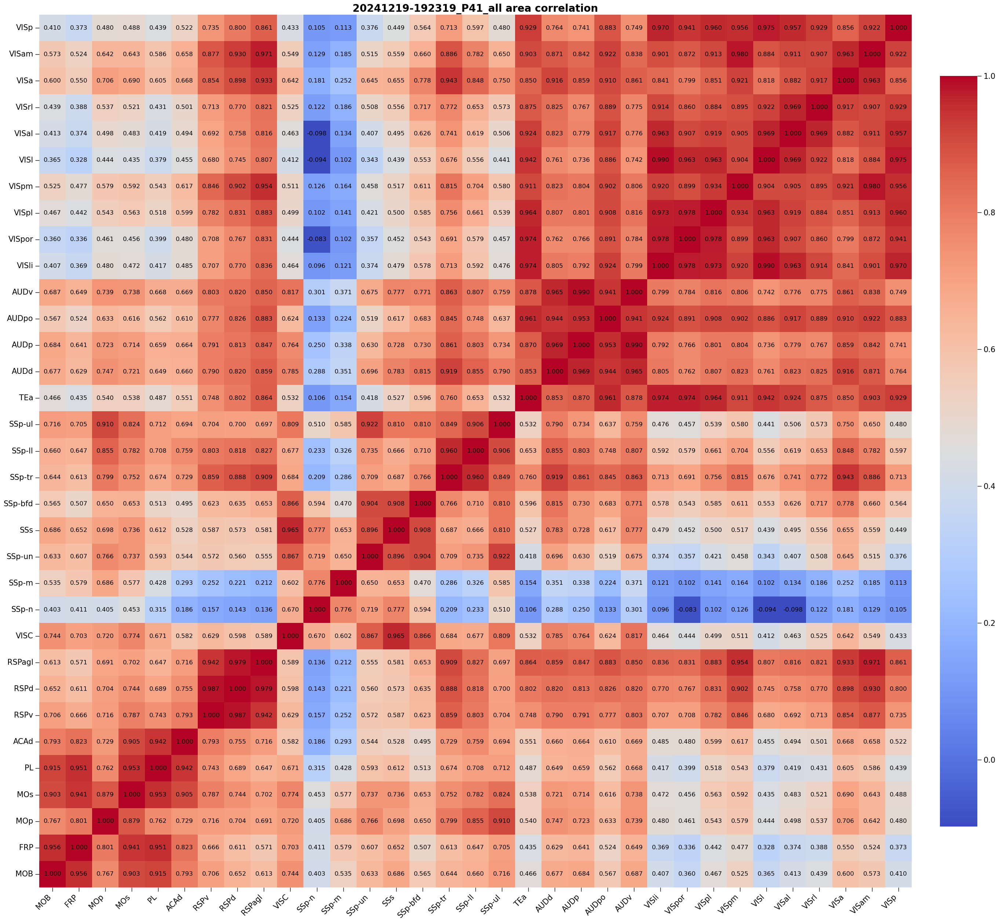

In [26]:
plot_heatmap(area_corr, xlabel=area_list1, ylabel=area_list1, cmap='coolwarm', vmin=None, vmax=None, title=f'{mouse}_{experiment}_all area correlation', 
             outfile=pjoin(path_out,f'{mouse}_{experiment}_all area correlation.png'), dpi=300, annot=True)

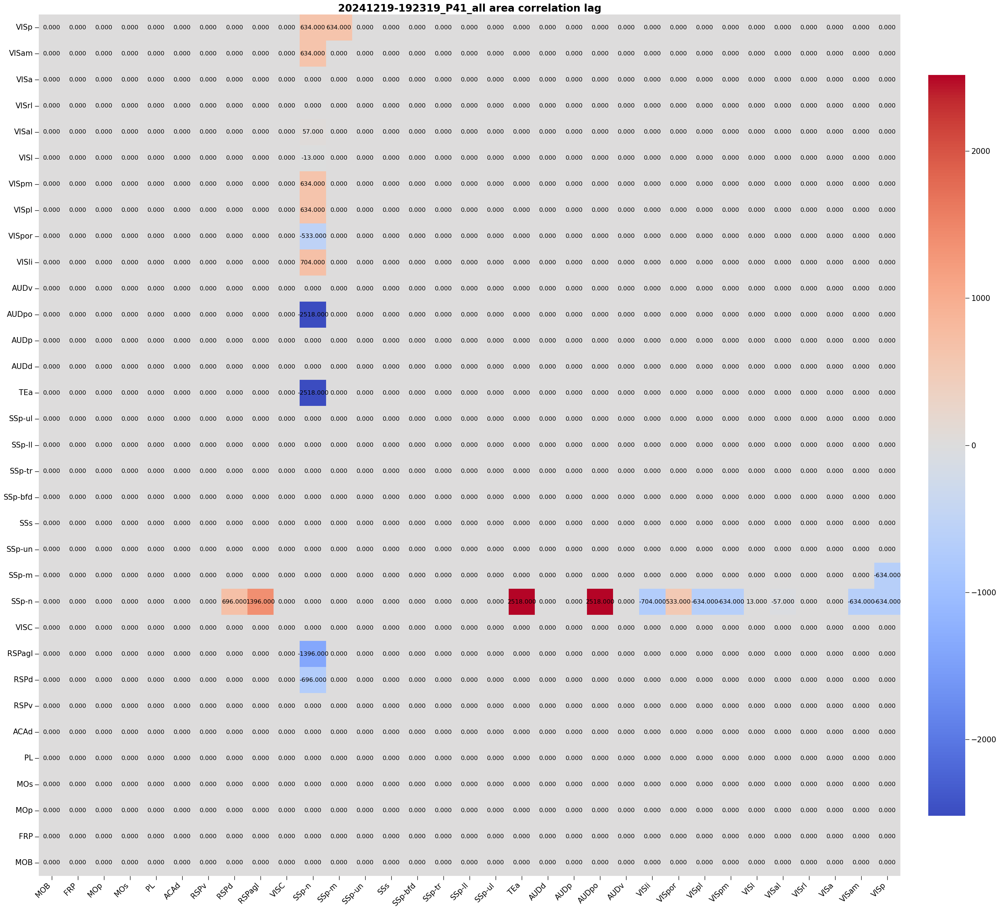

In [27]:
plot_heatmap(area_lag, xlabel=area_list1, ylabel=area_list1, cmap='coolwarm', vmin=None, vmax=None, title=f'{mouse}_{experiment}_all area correlation lag', 
             outfile=pjoin(path_out,f'{mouse}_{experiment}_all area correlation lag.png'), dpi=300, annot=True)

## cal std & snr

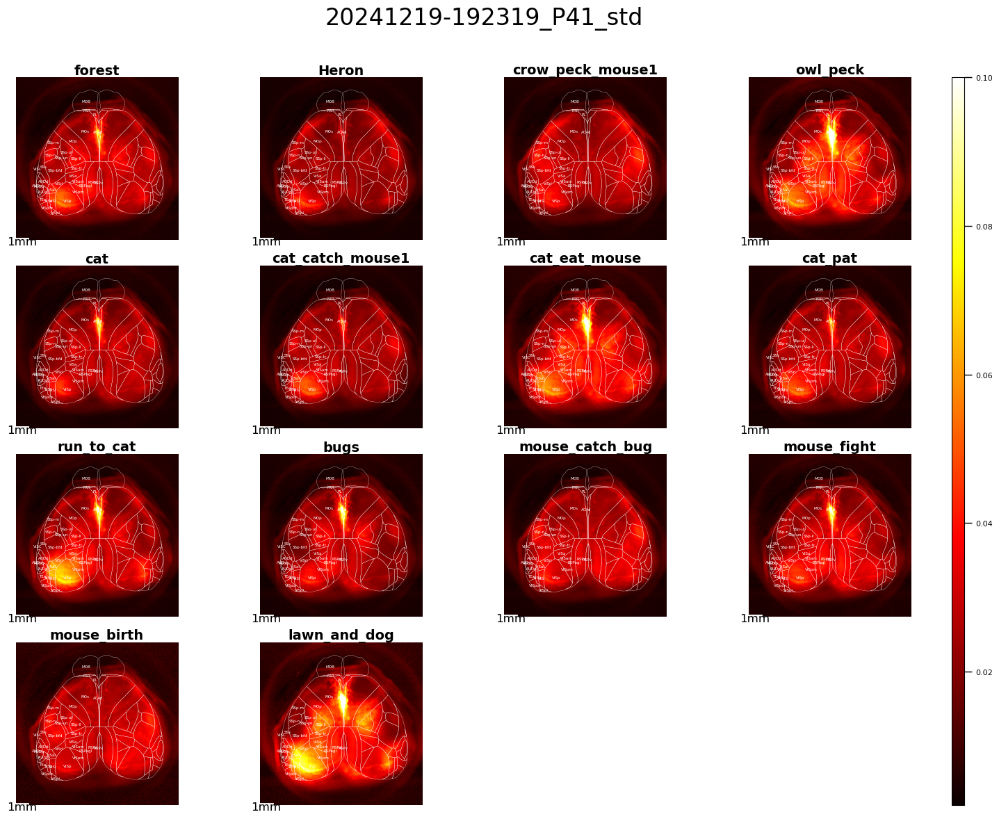

In [28]:
std=np.std(tif_sort, axis=(2,4))

subplot_movie_heatmap(std, 4, 4, movie_name_list, path_outfile=pjoin(path_out, f'{mouse}_{experiment}_std.png'),
                      title=f'{mouse}_{experiment}_std', vmax=0.1, pixel_um=26, patches=None,
                      ccf_regions=ccf_regions_im)

np.save(pjoin(path_out, f'{mouse}_{experiment}_std.npy'), std)

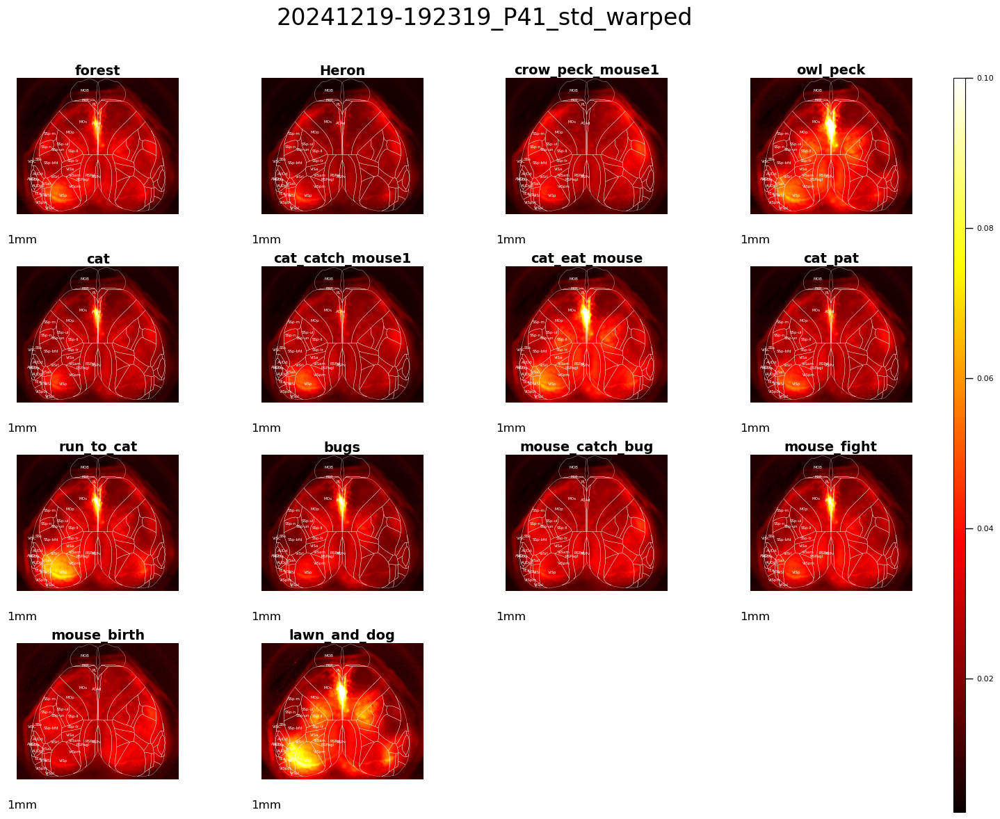

In [23]:
std_warped = warp(std,lmarks['transform'],
                order = 1, mode='constant', cval = 0, clip=True, preserve_range=True, output_shape=(540, 640))

subplot_movie_heatmap(std_warped, 4, 4, movie_name_list, path_outfile=pjoin(path_out, f'{mouse}_{experiment}_std_warped.png'),
                      title=f'{experiment}_{mouse}_std_warped', vmax=0.1, pixel_um=26, patches=None,
                      ccf_regions=ccf_regions)

np.save(pjoin(path_out, f'{mouse}_{experiment}_std_warped.npy'), std_warped)


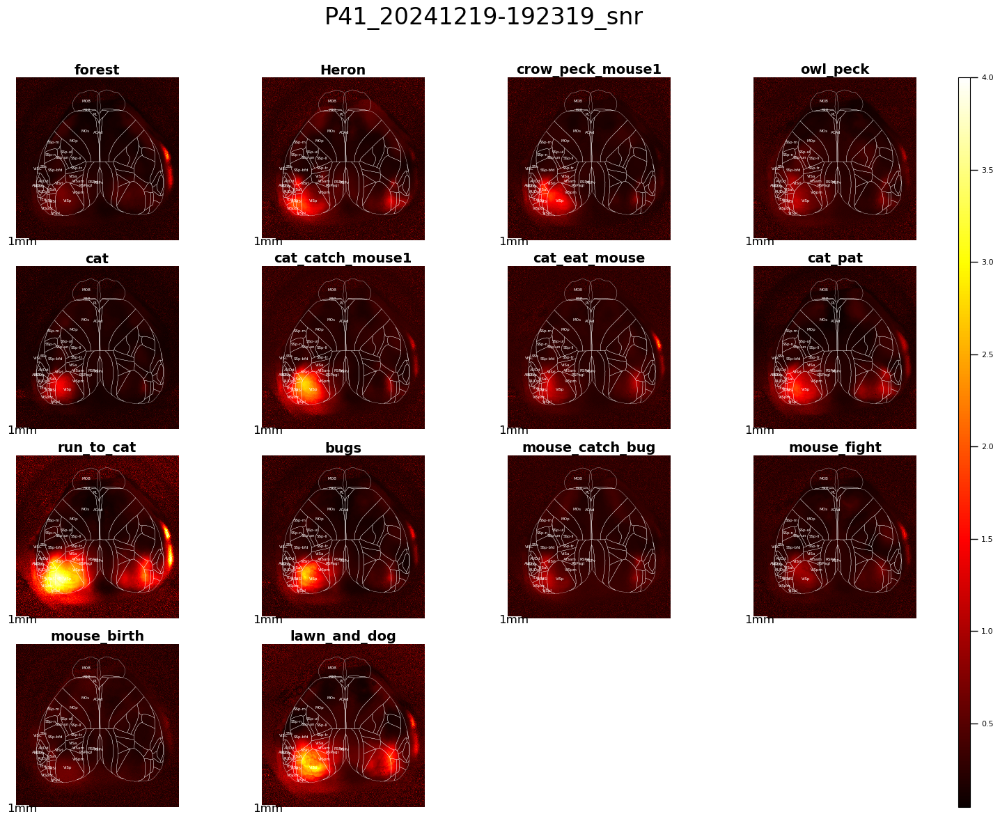

In [25]:
# snr = cal_snr(tif_sort, axis1=4, axis2=2)
snr = cp.asnumpy(Gcal_snr(tif_sort1, axis1=4, axis2=2))

subplot_movie_heatmap(snr, 4, 4, movie_name_list, path_outfile=pjoin(path_out, f'{mouse}_{experiment}_snr.png'),
                      title=f'{mouse}_{experiment}_snr', vmax=3, pixel_um=26, patches=None,
                      ccf_regions=ccf_regions_im)
np.save(pjoin(path_out, f'{mouse}_{experiment}_snr.npy'), snr)



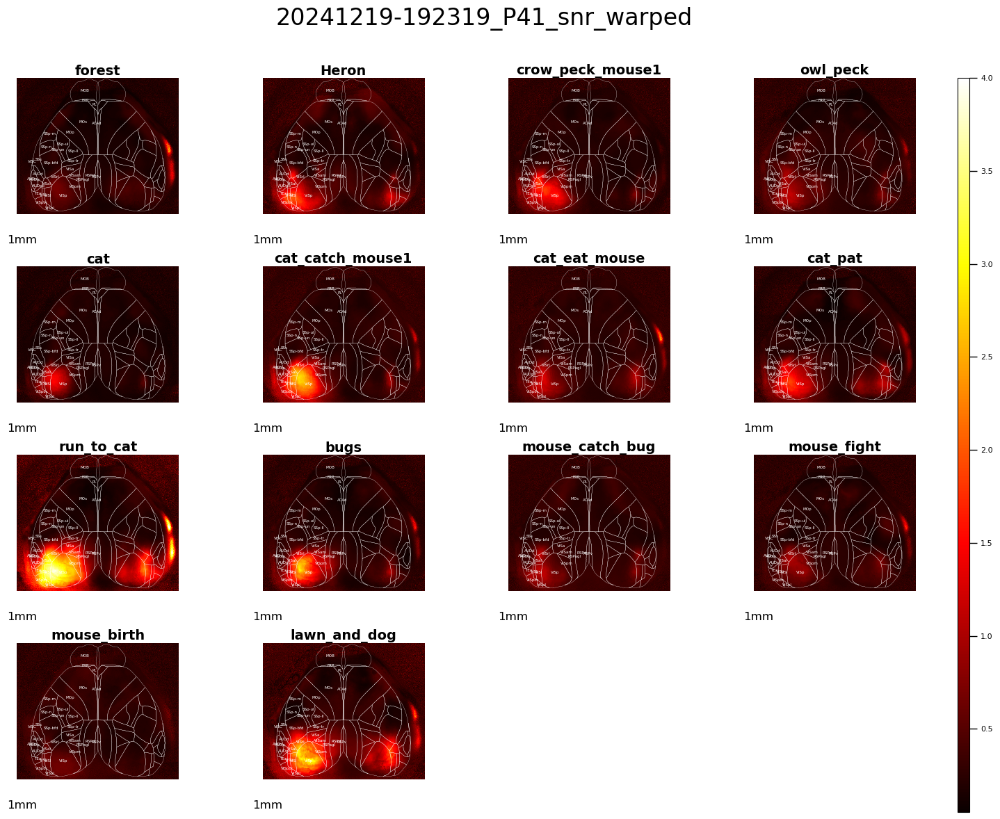

In [24]:
snr_warped = warp(snr,lmarks['transform'],
                order = 1, mode='constant', cval = 0, clip=True, preserve_range=True, output_shape=(540, 640))

subplot_movie_heatmap(snr_warped, 4, 4, movie_name_list, path_outfile=pjoin(path_out, f'{mouse}_{experiment}_snr_warped.png'),
                      title=f'{mouse}_{experiment}_snr_warped', vmax=3, pixel_um=26, patches=None,
                      ccf_regions=ccf_regions)

np.save(pjoin(path_out, f'{mouse}_{experiment}_snr_warped.npy'), snr_warped)

## test shuffled v1 snr

In [70]:
all_area_timecourse = np.load(pjoin(path_out, f'{mouse}_{experiment}_all_area_timecourse.npy'))

In [71]:
timecourse_v1 = all_area_timecourse[-1]
snr_v1 = cal_snr(timecourse_v1, 2, 0)

In [68]:

# cal V1_shuffle snr as baseline

snr_v1_shuffle = []
num_iterations = 1000

def shuffle_array(arr):
    np.random.shuffle(arr)
    return arr

for _ in range(num_iterations):

    timecourse_v1_shuffled = np.apply_along_axis(shuffle_array, axis=0, arr=timecourse_v1.copy())
    # 计算随机化后的 SNR
    snr_random = cal_snr(timecourse_v1_shuffled, 2, 0)
    snr_v1_shuffle.append(snr_random)

snr_v1_shuffle = np.asarray(snr_v1_shuffle)


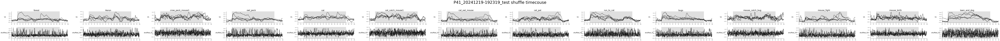

In [72]:
compare = np.stack((timecourse_v1,timecourse_v1_shuffled)).transpose(0,2,1,3)

subplot_timecourse(compare, patch_list=['V1','shuffled_V1'], movie_name_list=movie_name_list, title=f'{mouse}_{experiment}_test shuffle V1 timecouse', outpath='/home/lzx/data/WF_VC_liuzhaoxi/______________natural_movie_summary2', plot_rep=True, pre_length=pre_length,
             n_frame=n_frame, dpi=200)

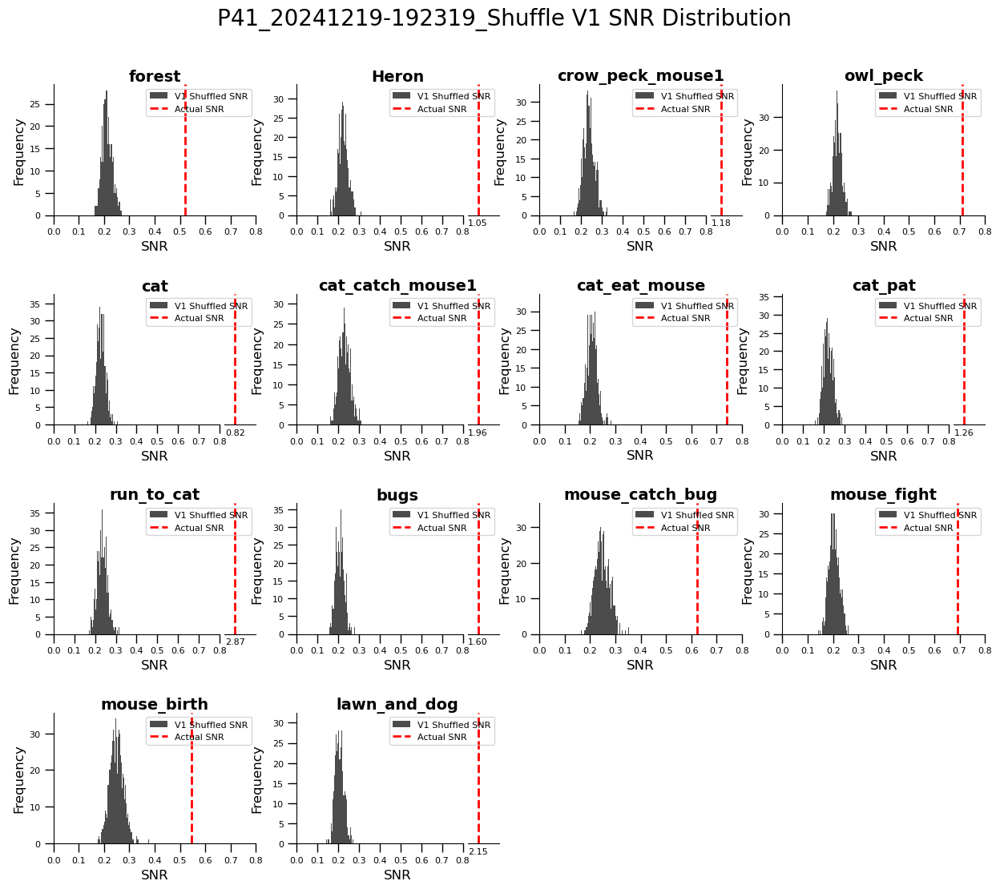

In [102]:
import matplotlib.ticker as ticker
from brokenaxes import brokenaxes

fig = plt.figure(figsize=(15, 12))

for i in range(4):
    for j in range(4):
        index = i * 4 + j
        if index < n_movie:
            actual_snr = snr_v1[index]
            if actual_snr > 0.8:
                # 使用 gridspec 定位，并设置 diag_color=None 移除斜杠
                bax = brokenaxes(
                    xlims=((0, 0.8), (actual_snr - 0.05, actual_snr + 0.1)),
                    subplot_spec=fig.add_gridspec(4, 4)[i, j],
                    despine=False,
                    wspace=0.05, 
                    d=0,                  # 分隔线宽度设为0
                )
                # 绘制直方图
                bax.hist(snr_v1_shuffle[:, index], color='k', bins=100, alpha=0.7, label='V1 Shuffled SNR')
                bax.axvline(actual_snr, color='r', linestyle='dashed', linewidth=2, label='Actual SNR')
                # 设置标题和标签
                bax.set_title(movie_name_list[index], pad=0)
                bax.set_xlabel('SNR', labelpad=23)
                bax.set_ylabel('Frequency')
                # 调整刻度
                bax.axs[0].xaxis.set_major_locator(ticker.MultipleLocator(0.1))
                bax.axs[1].xaxis.set_major_locator(ticker.NullLocator())
                bax.axs[1].xaxis.set_minor_locator(ticker.FixedLocator([actual_snr]))
                bax.axs[1].xaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2f'))
                bax.axs[1].tick_params(axis='x', which='minor', length=0)
                bax.legend(fontsize=8)
            else:
                # 正常情况
                ax = fig.add_subplot(4, 4, index + 1)
                ax.hist(snr_v1_shuffle[:, index], bins=100, alpha=0.7, label='V1 Shuffled SNR')
                ax.axvline(actual_snr, color='r', linestyle='dashed', linewidth=2, label='Actual SNR')
                ax.set_title(movie_name_list[index], pad=0)
                ax.set_xlabel('SNR')
                ax.set_xlim(0, 0.8)
                ax.xaxis.set_major_locator(ticker.MultipleLocator(0.1))
                ax.set_ylabel('Frequency')
                ax.legend(fontsize=8)


plt.suptitle(f'{mouse}_{experiment}_Shuffle V1 SNR Distribution', fontsize=20)
plt.subplots_adjust(top=0.90, hspace=0.6)
fig.set_facecolor('white')
plt.savefig(pjoin('/home/lzx/data/WF_VC_liuzhaoxi/______________natural_movie_summary2', 
                 f'{mouse}_{experiment}_Shuffle V1 SNR Distribution'), bbox_inches='tight')
plt.savefig(pjoin(path_out,
                  f'{mouse}_{experiment}_Shuffle V1 SNR Distribution'), bbox_inches='tight')
plt.show()